#  Capstone Project: Early Diabetes Detection System (EDDS)

---

###  Problem Statement

Diabetes is a chronic, global health condition that affects millions of people worldwide. It often develops silently, without noticeable symptoms, until severe complications such as heart disease, kidney failure, or blindness occur. Many cases remain undiagnosed until it is too late for effective intervention.  

**Early detection and timely management** are essential to preventing long-term damage and reducing the burden on individuals and healthcare systems.

---

###  Project Goal

The goal of this project is to develop a machine learning-based classification model that can **predict the likelihood of an individual developing diabetes** using basic medical and demographic features. These include indicators such as glucose level, BMI, age, family history, and other health parameters.

---

###  Why This Matters

Early prediction empowers individuals and healthcare professionals to take proactive measures, potentially preventing complications and reducing healthcare costs. This project seeks to create a system that:

-  **Supports doctors** with fast, data-driven clinical decision-making  
-  **Empowers individuals** with awareness of their risk and the ability to seek timely medical attention  
-  **Helps healthcare systems** implement scalable, automated screening to prioritize early intervention for high-risk populations  

By leveraging machine learning for early diabetes detection, this project offers **significant public health impact** enabling better outcomes through prevention, education, and efficient use of medical resources.

---

### Data

diabetes dataset comes from the Kaggle https://www.kaggle.com/datasets/asinow/diabetes-dataset. 

---


### Import and Setup

In [417]:
import numpy as np
import pandas as pd

# Preprocessing
from sklearn.model_selection import train_test_split, KFold, cross_val_score
from sklearn.preprocessing import StandardScaler

# Metrics
from sklearn.metrics import classification_report, confusion_matrix

# Statistical Tests
from scipy.stats import chi2_contingency, zscore, anderson, kruskal, mannwhitneyu

# Plotting
import matplotlib.pyplot as plt
import seaborn as sns
import itertools

# Ignoring warnings
import warnings
warnings.filterwarnings('ignore')
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt

from sklearn.model_selection import train_test_split, GridSearchCV
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import accuracy_score, f1_score, roc_auc_score, classification_report, confusion_matrix
from sklearn.model_selection import StratifiedKFold

# Models
from sklearn.linear_model import LogisticRegression
from sklearn.neighbors import KNeighborsClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.svm import SVC
from sklearn.naive_bayes import GaussianNB
from sklearn.tree import DecisionTreeClassifier

### Read Data

In [420]:
diabetes = pd.read_csv("data/diabetes_dataset.csv")

### Data Overview

In [423]:
diabetes.head()

,Age,Pregnancies,BMI,Glucose,BloodPressure,HbA1c,LDL,HDL,Triglycerides,WaistCircumference,HipCircumference,WHR,FamilyHistory,DietType,Hypertension,MedicationUse,Outcome
0,69,5,28.39,130.1,77.0,5.4,130.4,44.0,50.0,90.5,107.9,0.84,0,0,0,1,0
1,32,1,26.49,116.5,72.0,4.5,87.4,54.2,129.9,113.3,81.4,1.39,0,0,0,0,0
2,89,13,25.34,101.0,82.0,4.9,112.5,56.8,177.6,84.7,107.2,0.79,0,0,0,1,0
3,78,13,29.91,146.0,104.0,5.7,50.7,39.1,117.0,108.9,110.0,0.99,0,0,0,1,1
4,38,8,24.56,103.2,74.0,4.7,102.5,29.1,145.9,84.1,92.8,0.91,0,1,0,0,0


### Basic Exploration

- Age: Age of the individual (18–90 years).
- Pregnancies: Number of times the patient has been pregnant.
- BMI (Body Mass Index): A measure of body fat based on height and weight (kg/m²).
- Glucose: Blood glucose concentration (mg/dL); a key indicator of diabetes.
- BloodPressure: Systolic blood pressure (mmHg); elevated levels may indicate hypertension.
- HbA1c: Hemoglobin A1c level (%); reflects average blood sugar levels over the past few months.
- LDL (Low-Density Lipoprotein): "Bad" cholesterol level (mg/dL).
- HDL (High-Density Lipoprotein): "Good" cholesterol level (mg/dL).
- Triglycerides: Fat levels in the blood (mg/dL); high values increase the risk of diabetes.
- WaistCircumference: Waist measurement (cm); an indicator of central obesity.
- HipCircumference: Hip measurement (cm); used in calculating waist-to-hip ratio.
- WHR (Waist-to-Hip Ratio): Waist circumference divided by hip circumference.
- FamilyHistory: Indicates whether the individual has a family history of diabetes (1 = Yes, 0 = No).
- DietType: Dietary habits  
  - 0 = Unbalanced  
  - 1 = Balanced  
  - 2 = Vegan/Vegetarian
- Hypertension: Presence of high blood pressure (1 = Yes, 0 = No).
- MedicationUse: Indicates whether the individual is currently taking medication (1 = Yes, 0 = No).
- Outcome: Diabetes diagnosis result (1 = Diabetes, 0 = No Diabetes).


#### Checking null values and data types

In [428]:
diabetes.info() 

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 9538 entries, 0 to 9537
Data columns (total 17 columns):
 #   Column              Non-Null Count  Dtype  
---  ------              --------------  -----  
 0   Age                 9538 non-null   int64  
 1   Pregnancies         9538 non-null   int64  
 2   BMI                 9538 non-null   float64
 3   Glucose             9538 non-null   float64
 4   BloodPressure       9538 non-null   float64
 5   HbA1c               9538 non-null   float64
 6   LDL                 9538 non-null   float64
 7   HDL                 9538 non-null   float64
 8   Triglycerides       9538 non-null   float64
 9   WaistCircumference  9538 non-null   float64
 10  HipCircumference    9538 non-null   float64
 11  WHR                 9538 non-null   float64
 12  FamilyHistory       9538 non-null   int64  
 13  DietType            9538 non-null   int64  
 14  Hypertension        9538 non-null   int64  
 15  MedicationUse       9538 non-null   int64  
 16  Outcom

#### ✅ Insight: Dataset Structure and Quality

- The dataset contains 9,538 records and 17 features.
- No missing values were detected - all columns have complete data.
- Data types are appropriate:
  - Float64 for continuous variables (e.g., BMI, Glucose, HDL).
  - Int64 for categorical/discrete variables (e.g., Age, FamilyHistory, Outcome).
- Memory usage is efficient (~1.2 MB), indicating a manageable dataset size for analysis and model training.


In [431]:
diabetes.duplicated().sum()

0

#### ✅ Insight: Duplicate Check

- No duplicate rows were found in the dataset (`diabetes.duplicated().sum() = 0`).
- No additional cleaning is required for duplication.
- Helps ensure unbiased model training and reliable evaluation.


In [434]:
print(f'''number of rows - {diabetes.shape[0]}
number of columns - {diabetes.shape[1]}''')

number of rows - 9538
number of columns - 17


#### ✅ Insight: Dataset Dimensions

- The dataset contains **9,538 rows** and **17 columns**.
- The number of features (17) provides a rich set of variables for predictive modeling.
- The dataset is sufficiently large for training machine learning models with good generalization potential.


In [437]:
diabetes.nunique()

Age                     72
Pregnancies             17
BMI                   2378
Glucose               1098
BloodPressure           77
HbA1c                   28
LDL                   1457
HDL                    832
Triglycerides         2046
WaistCircumference     839
HipCircumference       742
WHR                    102
FamilyHistory            2
DietType                 3
Hypertension             2
MedicationUse            2
Outcome                  2
dtype: int64

#### ✅ Insight: Feature Uniqueness and Variability

- Continuous variables like BMI (2378 unique values), Glucose (1098 unique), LDL (1457 unique), and Triglycerides (2046 unique) show high variability, providing rich information for prediction.
- Categorical/binary variables such as FamilyHistory (2 unique values), Hypertension (2 unique values), MedicationUse (2 unique values), and Outcome (2 unique values) have limited distinct values, suitable for classification tasks.
- Features like Age (72 unique values) and Pregnancies (17 unique values) show moderate granularity.
- This diversity in feature uniqueness suggests a balanced dataset with both continuous and categorical variables, useful for robust modeling.


In [440]:
diabetes.columns = diabetes.columns.str.lower()  

diabetes = diabetes.replace({'N/A': 'not applicable', 'Not Applicable': 'not applicable'})

#### ✅ Insight: Data Cleaning and Standardization

- Column names were standardized to lowercase to ensure consistency and avoid case-sensitive errors during analysis.
- Inconsistent categorical labels such as 'N/A' and 'Not Applicable' were unified into a single label ('not applicable') to maintain data integrity.
- These cleaning steps improve data quality by reducing ambiguity and facilitating smoother preprocessing and modeling workflows.


In [443]:
def null_count():
    return pd.DataFrame({'features': diabetes.columns,
                'dtypes': diabetes.dtypes.values,
                'NaN count': diabetes.isnull().sum().values,
                'NaN percentage': diabetes.isnull().sum().values/diabetes.shape[0]}).style.background_gradient(cmap='Blues',low=0.1,high=0.01)
null_count()

,features,dtypes,NaN count,NaN percentage
0,age,int64,0,0.000000
1,pregnancies,int64,0,0.000000
2,bmi,float64,0,0.000000
3,glucose,float64,0,0.000000
4,bloodpressure,float64,0,0.000000
5,hba1c,float64,0,0.000000
6,ldl,float64,0,0.000000
7,hdl,float64,0,0.000000
8,triglycerides,float64,0,0.000000
9,waistcircumference,float64,0,0.000000


#### ✅ Insight: Missing Values

- No missing values were found in any of the 17 features.
- This means the dataset is complete and requires no imputation or removal of missing data.
- Having a fully populated dataset simplifies preprocessing and enhances model reliability.


In [446]:
diabetes.describe() 

,age,pregnancies,bmi,glucose,bloodpressure,hba1c,ldl,hdl,triglycerides,waistcircumference,hipcircumference,whr,familyhistory,diettype,hypertension,medicationuse,outcome
count,9538.000000,9538.000000,9538.000000,9538.000000,9538.000000,9538.000000,9538.000000,9538.000000,9538.000000,9538.000000,9538.000000,9538.000000,9538.000000,9538.000000,9538.000000,9538.000000,9538.000000
mean,53.577584,7.986161,27.052364,106.104183,84.475781,4.650661,100.133456,49.953418,151.147746,93.951678,103.060621,0.917400,0.302474,0.486161,0.001048,0.405012,0.344097
std,20.764651,4.933469,5.927955,21.918590,14.123480,0.476395,29.911910,15.242194,48.951627,15.594468,13.438827,0.140828,0.459354,0.661139,0.032364,0.490920,0.475098
min,18.000000,0.000000,15.000000,50.000000,60.000000,4.000000,-12.000000,-9.200000,50.000000,40.300000,54.800000,0.420000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,36.000000,4.000000,22.870000,91.000000,74.000000,4.300000,80.100000,39.700000,117.200000,83.400000,94.000000,0.820000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,53.000000,8.000000,27.050000,106.000000,84.000000,4.600000,99.900000,50.200000,150.550000,93.800000,103.200000,0.910000,0.000000,0.000000,0.000000,0.000000,0.000000
75%,72.000000,12.000000,31.180000,121.000000,94.000000,5.000000,120.200000,60.200000,185.100000,104.600000,112.100000,1.010000,1.000000,1.000000,0.000000,1.000000,1.000000
max,89.000000,16.000000,49.660000,207.200000,138.000000,6.900000,202.200000,107.800000,345.800000,163.000000,156.600000,1.490000,1.000000,2.000000,1.000000,1.000000,1.000000


#### ✅ Insight: Summary Statistics of the Dataset

- The dataset contains 9,538 records with no missing values, providing a solid foundation for analysis.
- Age ranges from 18 to 89 years with a mean of ~54 years, indicating a mostly adult to senior population.
- Pregnancies range from 0 to 16, with a median of 8, reflecting diverse reproductive histories.
- BMI varies widely (15.0 to 49.66) with an average around 27, suggesting a mix of normal, overweight, and obese individuals.
- Key diabetes indicators such as Glucose (mean ~106 mg/dL), HbA1c (mean ~4.65%), and Blood Pressure (mean ~84 mmHg) show expected clinical ranges, though outliers and negative values in LDL and HDL suggest some data quality checks may be needed.
- Cholesterol values (LDL, HDL) and Triglycerides exhibit wide distributions, indicating variability in lipid profiles across the population.
- Waist and hip circumference, and derived WHR, suggest diverse body shapes and obesity risk factors.
- Categorical features like FamilyHistory, DietType, Hypertension, and MedicationUse show expected binary or low-level discrete values.
- The Outcome variable is binary (0 or 1), representing diabetes diagnosis status.
- feature scaling needs to be performed.

### Univariate Analysis


#### Categorical Features¶


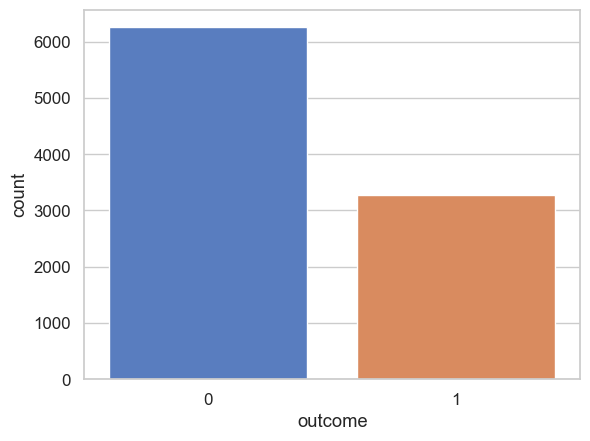

In [451]:
sns.countplot(x=diabetes.outcome, palette='muted')
plt.show()

#### ✅ Insight: Class Imbalance and Data Splitting

- The dataset exhibits class imbalance in the Outcome variable, meaning one class (e.g., non-diabetic) has significantly more samples than the other.
- Because of this imbalance, accuracy alone is not a reliable metric to evaluate model performance.
- Metrics such as F1 score, ROC-AUC, and precision/recall should be considered for a more balanced evaluation.
- When splitting the data into training and testing sets, stratification based on the Outcome column is essential to maintain the original class distribution in both subsets.


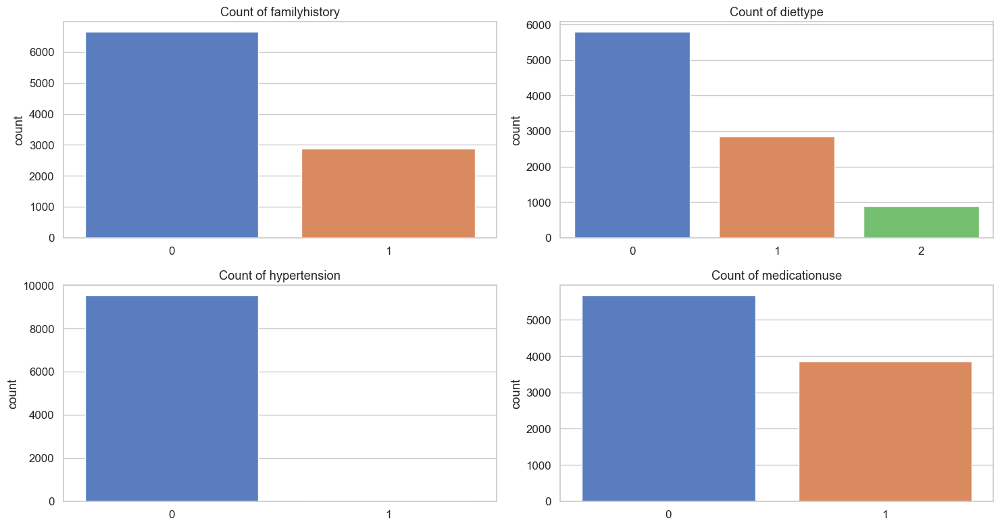

In [454]:
cat_columns = ['familyhistory', 'diettype', 'hypertension', 'medicationuse']

fig, ax = plt.subplots(2,2, figsize=(15,8))
ax = ax.flatten()

for i, col in enumerate(cat_columns):
    sns.countplot(x=diabetes[col], ax=ax[i], palette='muted')
    ax[i].set_title(f"Count of {col}")
    ax[i].set_xlabel('')
    
plt.tight_layout()
plt.show()

In [455]:
diabetes['hypertension'].value_counts(normalize=True)


hypertension
0    0.998952
1    0.001048
Name: proportion, dtype: float64

#### Insight: Hypertension

- The values in this column are highly imbalanced, with most entries concentrated in one category.  
- Due to this imbalance, the feature may offer limited value in distinguishing outcomes and could introduce noise.  
- It is safe to remove the Hypertension feature from the dataset to simplify the model and improve focus on more informative variables.


In [459]:
diabetes.drop('hypertension', axis=1, inplace=True)
cat_columns.remove('hypertension')

#### Numerical Features


#### Used the Anderson-Darling test for normality here since it is preferred for fairly large data. (n > 50)

In [463]:
# For a statistical guarantee
def check_normality(col):
    result = anderson(col, dist='norm')
    index_5 = np.where(result.significance_level == 5)[0][0]

    if result.statistic < result.critical_values[index_5]:
        return True
    else:
        return False

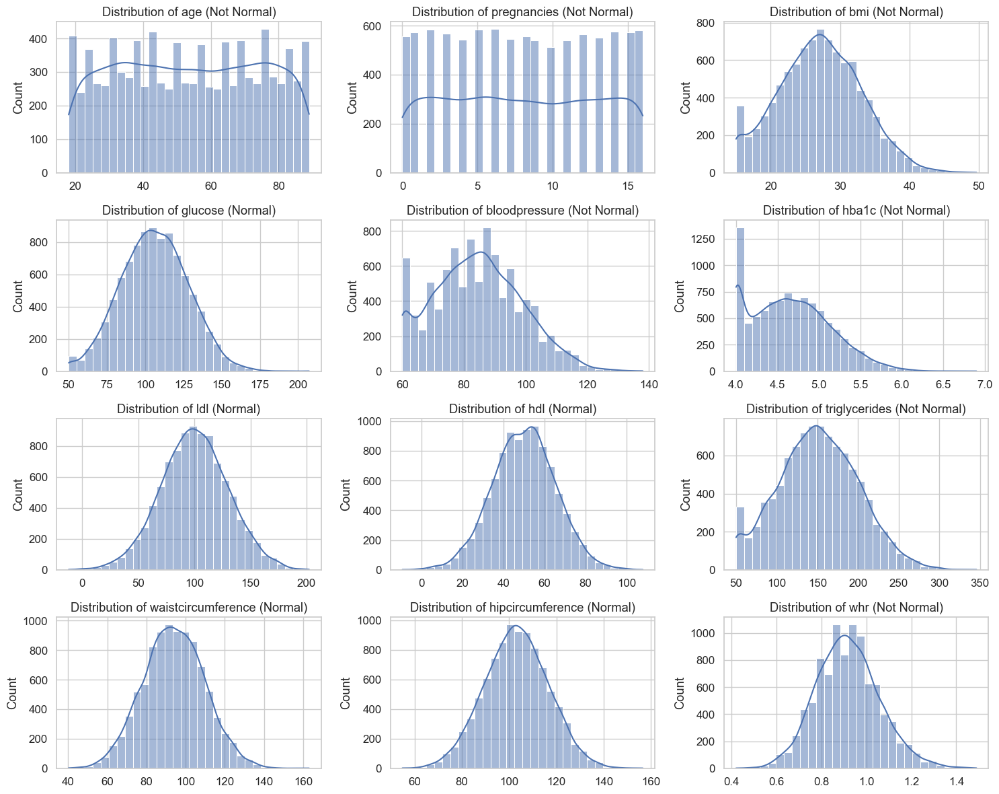

In [465]:
fig, ax = plt.subplots(4, 3, figsize=(15, 12))
ax = ax.flatten()

num_columns = ['age', 'pregnancies']
num_columns.extend(diabetes.select_dtypes(include='float').columns.to_list())

for i, col in enumerate(num_columns):
    sns.histplot(diabetes[col], bins=30, kde=True, ax=ax[i],  palette='muted')
    ax[i].set_title(f"Distribution of {col} ({'Normal' if check_normality(diabetes[col]) else 'Not Normal'})")
    ax[i].set_xlabel('')

plt.tight_layout()
plt.show()

#### ✅ Insights

-  Uniform Distributions: Age and Pregnancies  
-  Normal Distributions: Glucose, LDL, Waist Circumference, HDL, and Hip Circumference  
-  Non-Normal Distributions: Blood Pressure, BMI, HbA1c, Triglycerides, and WHR  


In [467]:
normal_cols = ['glucose', 'ldl', 'waistcircumference', 'hdl', 'hipcircumference']
non_normal_cols = ['bloodpressure', 'bmi', 'hba1c', 'triglycerides', 'whr']

### Outlier Detection

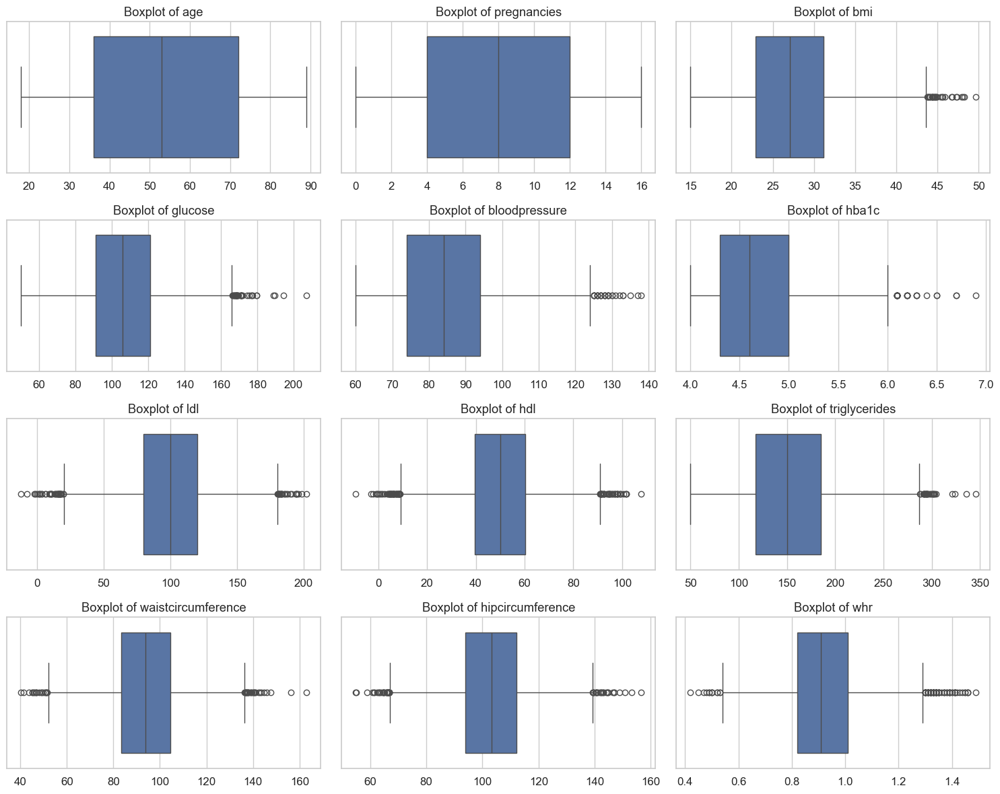

In [469]:
fig, ax = plt.subplots(4, 3, figsize=(15, 12))
ax = ax.flatten()

for i, col in enumerate(num_columns):
    sns.boxplot(x=diabetes[col], ax=ax[i])
    ax[i].set_title(f"Boxplot of {col}")
    ax[i].set_xlabel('')

plt.tight_layout()
plt.show()

In [470]:
def outlier_percentages(df, column):
    Q1 = df[column].quantile(0.25)
    Q3 = df[column].quantile(0.75)
    IQR = Q3 - Q1

    lower_bound = Q1 - 1.5 * IQR
    upper_bound = Q3 + 1.5 * IQR

    outliers = df[(df[column] < lower_bound) | (df[column] > upper_bound)]
    percentage = (len(outliers) / len(df)) * 100

    return round(percentage, 2)

In [471]:
for col in num_columns:
    outlier_percentage = outlier_percentages(diabetes, col)
    print(f"Outlier Percentage in {col}: {outlier_percentage}%")

Outlier Percentage in age: 0.0%
Outlier Percentage in pregnancies: 0.0%
Outlier Percentage in bmi: 0.3%
Outlier Percentage in glucose: 0.36%
Outlier Percentage in bloodpressure: 0.31%
Outlier Percentage in hba1c: 0.33%
Outlier Percentage in ldl: 0.67%
Outlier Percentage in hdl: 0.92%
Outlier Percentage in triglycerides: 0.3%
Outlier Percentage in waistcircumference: 0.48%
Outlier Percentage in hipcircumference: 0.58%
Outlier Percentage in whr: 0.91%


#### ✅ Insights

- Uniform Distributions: Age and Pregnancies  
- Normal Distributions: Glucose, LDL, Waist Circumference, HDL, and Hip Circumference  
- Non-Normal Distributions: Blood Pressure, BMI, HbA1c, Triglycerides, and WHR  
- Since the outliers don't exceed 1% in any feature, it is safe to remove them  


In [473]:
diabetes.shape

(9538, 16)

In [474]:
def remove_outliers(df, column):
    Q1 = df[column].quantile(0.25)
    Q3 = df[column].quantile(0.75)
    IQR = Q3 - Q1

    lower_bound = Q1 - 1.5 * IQR
    upper_bound = Q3 + 1.5 * IQR

    return df[(df[column] >= lower_bound) & (df[column] <= upper_bound)]

In [477]:
for col in num_columns:
    diabetes_df = remove_outliers(diabetes, col)
diabetes_df.shape

(9451, 16)

#### ✅ Insights

- Since the outliers don't exceed 1% in any feature, it is safe to remove them  
- We only removed around 5% of the data  


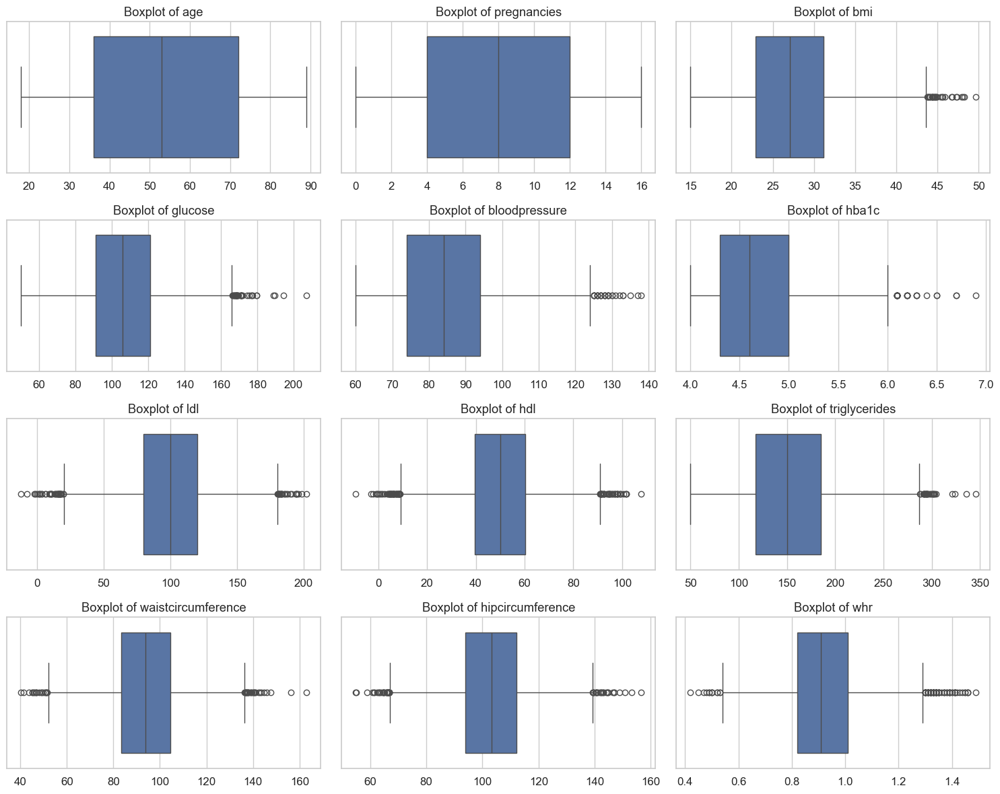

In [479]:
# Re-checking outliers.
fig, ax = plt.subplots(4, 3, figsize=(15, 12))
ax = ax.flatten()

for i, col in enumerate(num_columns):
    sns.boxplot(x=diabetes[col], ax=ax[i])
    ax[i].set_title(f"Boxplot of {col}")
    ax[i].set_xlabel('')

plt.tight_layout()
plt.show()

### Multivariate Analysis

#### Correlation Analysis¶


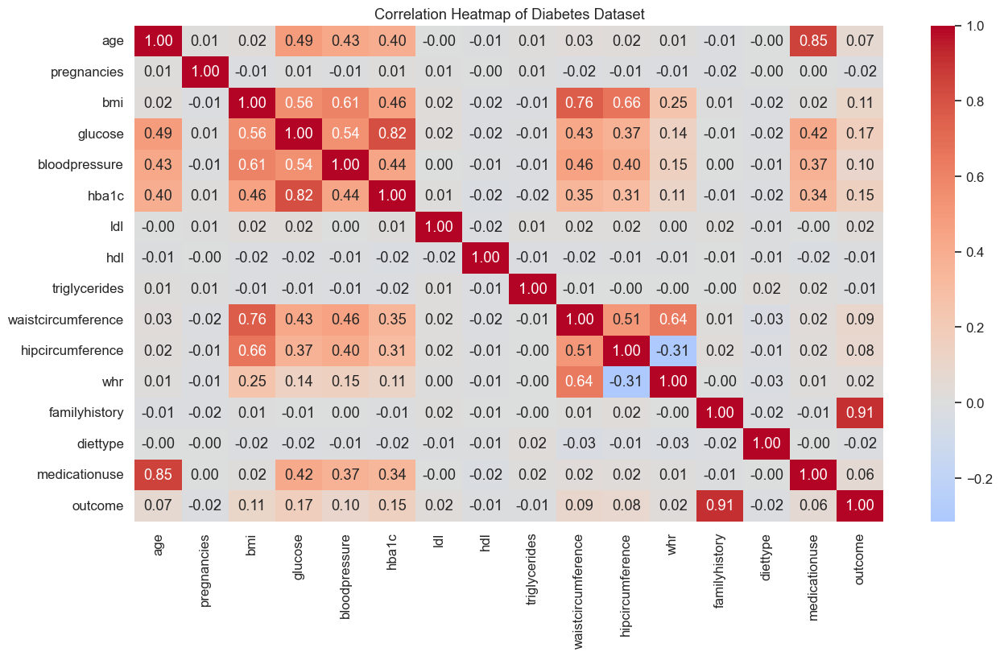

In [482]:
plt.figure(figsize=(15, 8))
sns.heatmap(diabetes.corr(), annot=True, fmt='.2f', cmap='coolwarm', center=0)
plt.title("Correlation Heatmap of Diabetes Dataset")
plt.show()

#### ✅ Insights:

- Family History is highly correlated with whether a person has diabetes or not.
- Multicollinearity seems to exist between Age and MedicationUse as well as HbA1c and Glucose.

### Multiple Categorical Features


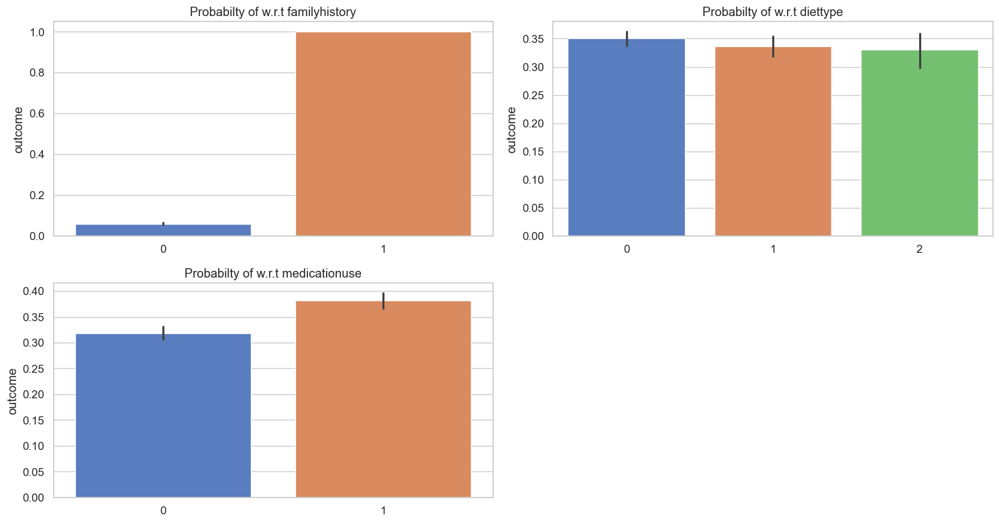

In [491]:
fig, ax = plt.subplots(2,2, figsize=(15,8))
ax = ax.flatten()

for i, col in enumerate(cat_columns):
    sns.barplot(data=diabetes, x=col, y='outcome', ax=ax[i],  palette='muted')
    ax[i].set_title(f'Probabilty of w.r.t {col}')
    ax[i].set_xlabel('')

fig.delaxes(ax[3])
plt.tight_layout()
plt.show()

#### Insights:

- FamilyHistory shows a strong relationship with the outcome.
- DietType has little effect on the outcome.
- MedicationUse correlates a bit, but needs further investigation.

In [493]:
# To check if the rest of the categorical features affect the outcome.
for col in cat_columns:
    contingency_table = pd.crosstab(diabetes[col], diabetes["outcome"])
    chi2, p, dof, expected = chi2_contingency(contingency_table)
    print(f"Feature: {col}")
    print(f"P-value: {p:.4f} which is {'less than' if p < 0.05 else 'greater than'} 0.05")
    print("-" * 75)

Feature: familyhistory
P-value: 0.0000 which is less than 0.05
---------------------------------------------------------------------------
Feature: diettype
P-value: 0.3010 which is greater than 0.05
---------------------------------------------------------------------------
Feature: medicationuse
P-value: 0.0000 which is less than 0.05
---------------------------------------------------------------------------


#### Insight: 
- DietType doesn't significantly affect the outcome. It can be dropped.

In [495]:
diabetes.drop('diettype', axis=1, inplace=True)
cat_columns.remove('diettype')

#### Multiple Numerical Features


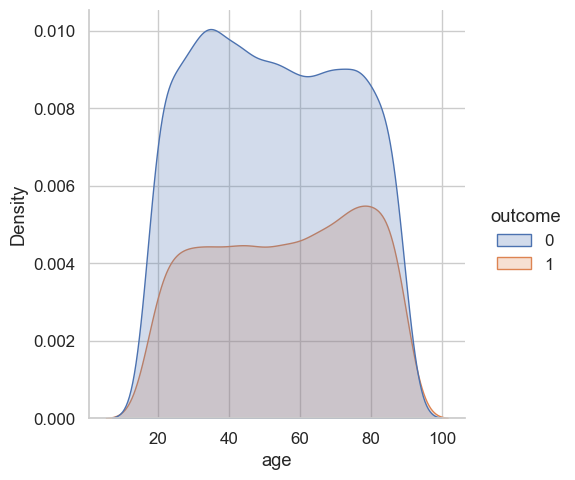

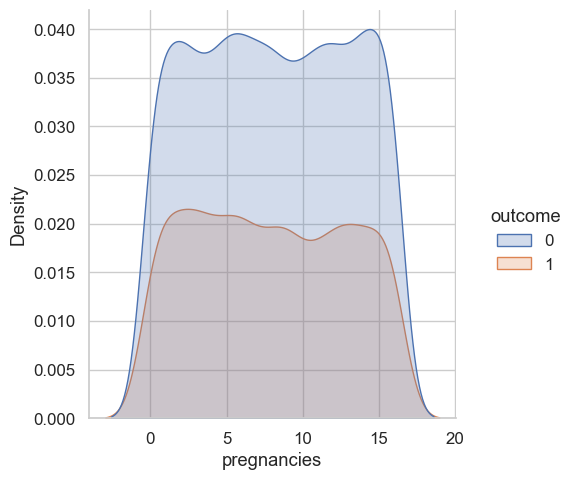

In [497]:
for i, col in enumerate(['age', 'pregnancies']):
    sns.displot(data=diabetes, x=col, hue='outcome', kind='kde', fill=True)
    plt.show()

#### Insight: 
- Neither Pregnancies nor Age can predict the outcome.

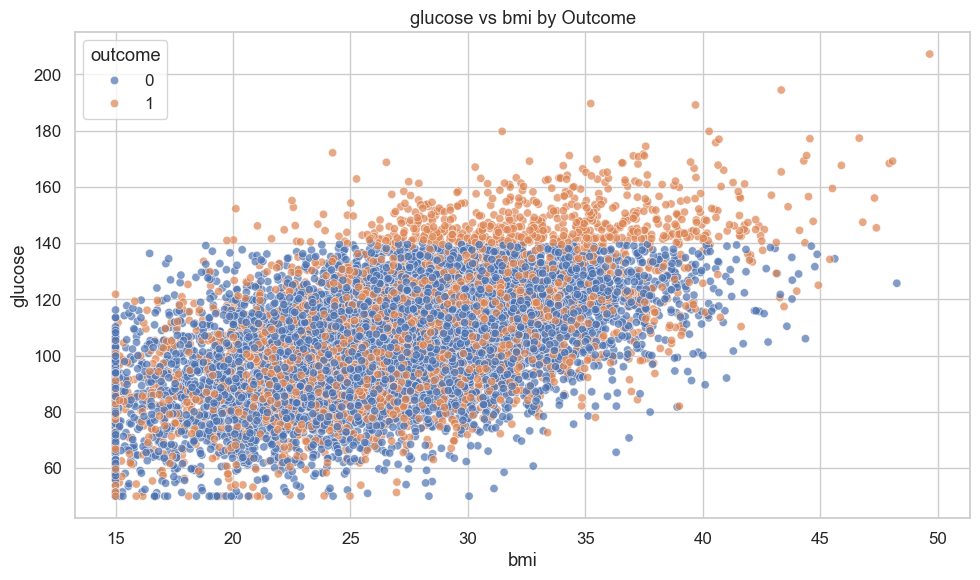

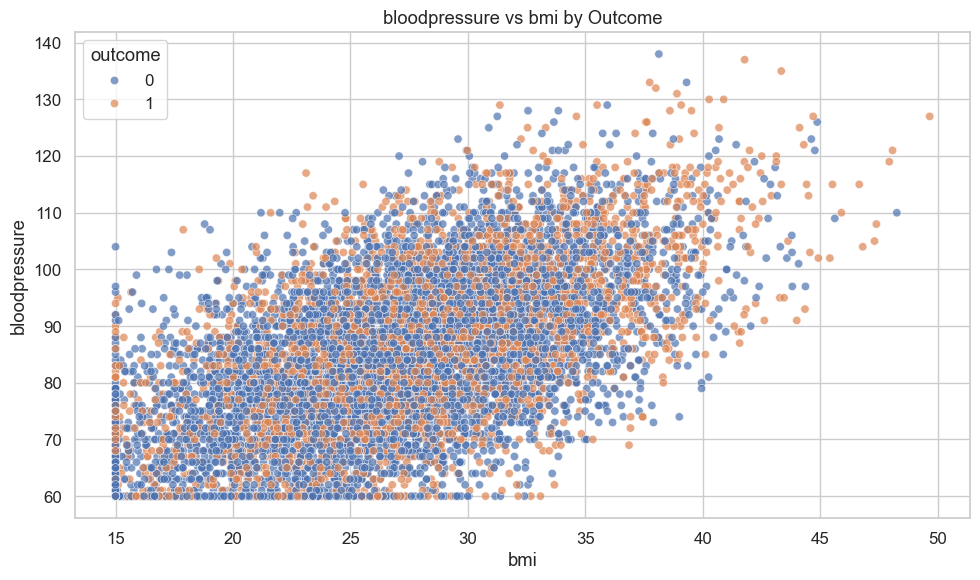

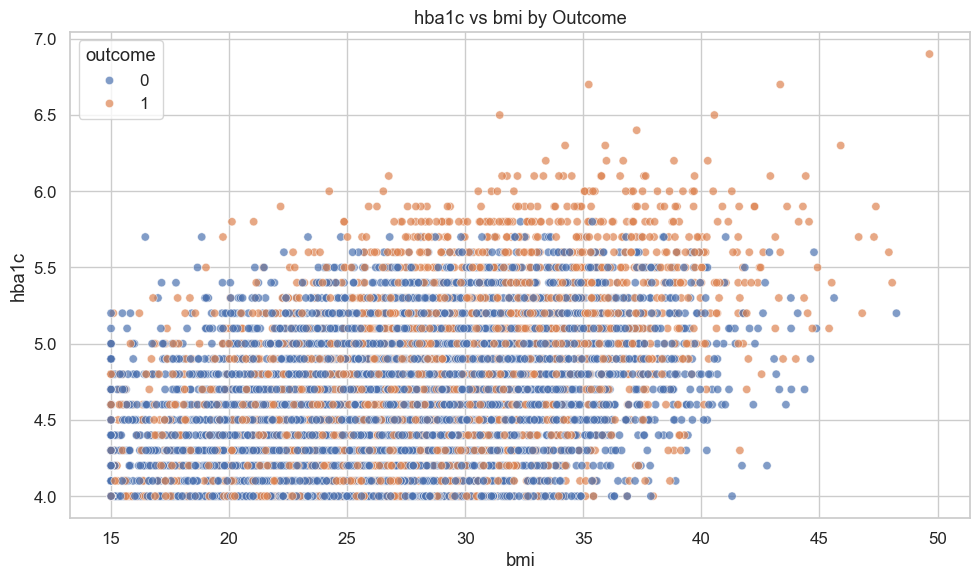

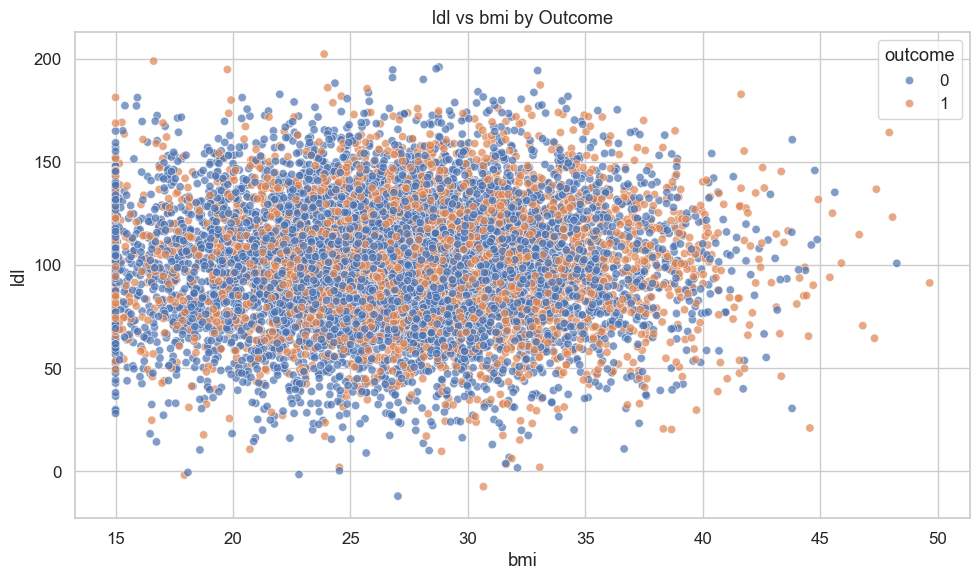

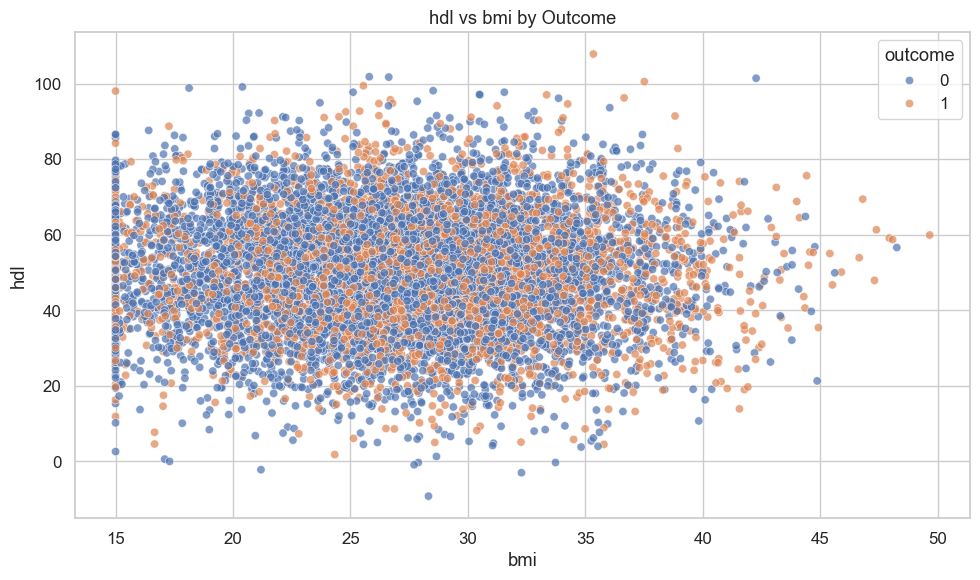

...

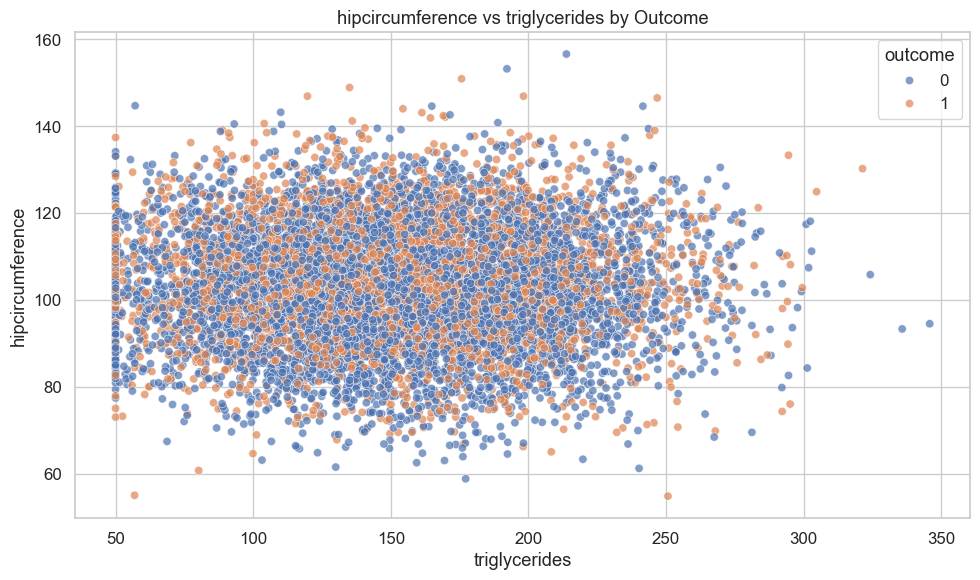

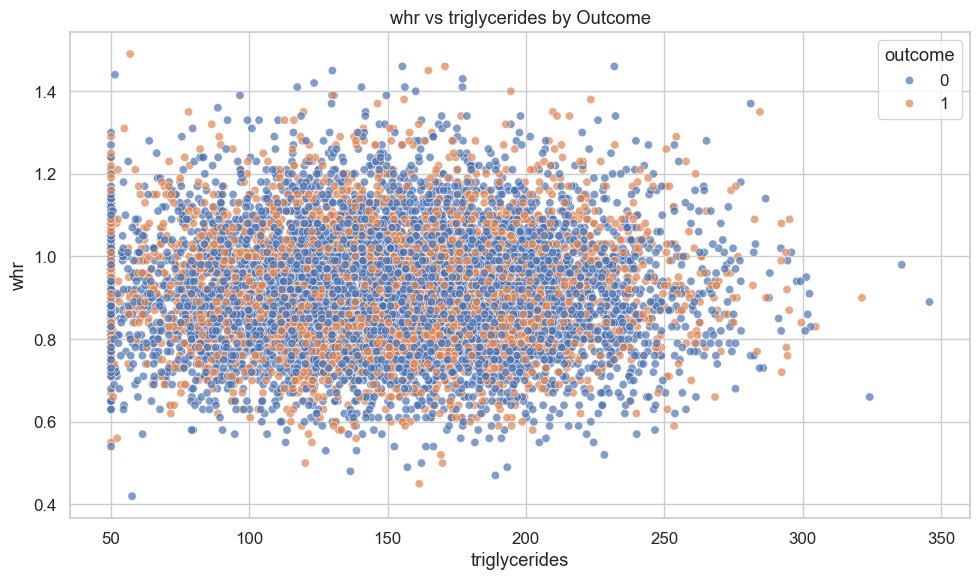

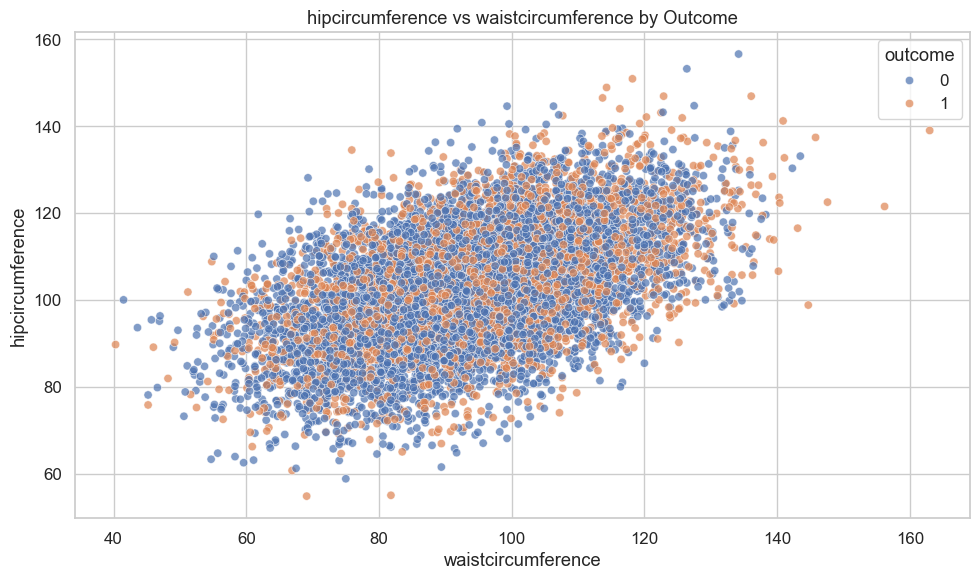

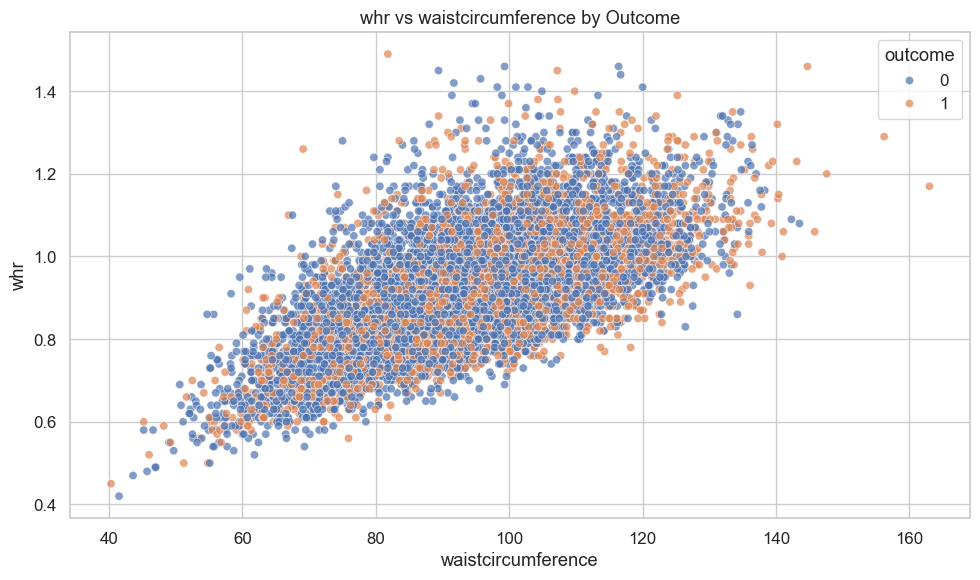

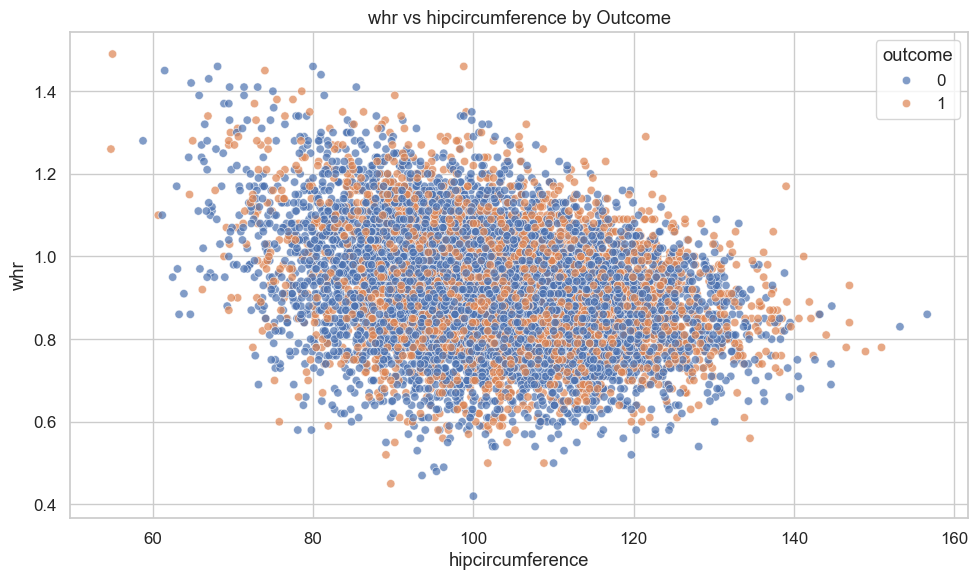

In [500]:
# Select only float columns
float_cols = diabetes.select_dtypes(include='float').columns

# Create all possible pairs of float columns
pairs = list(itertools.combinations(float_cols, 2))

# Loop through each pair and plot them
for x_var, y_var in pairs:
    plt.figure(figsize=(10, 6))  # Bigger figure
    sns.scatterplot(data=diabetes, x=x_var, y=y_var, hue='outcome', alpha=0.7)
    plt.title(f'{y_var} vs {x_var} by Outcome')
    plt.grid(True)
    plt.tight_layout()
    plt.show()

#### Insights:

Glucose and HbA1c can help predict the outcome, however there is a strong linear correlation between them. We can choose one to reduce multicollinearity. I will choose Glucose since it seems to differentiate between the outcomes better.
Seems like the rest of the features will not be able to help us in our prediction.

### Modelling

#### Train/Test Split

In [505]:
# Define X and y
X = diabetes.drop('outcome', axis=1).values
y = diabetes['outcome'].values

In [506]:
# Split the dataset into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, stratify=y, random_state=42, test_size=0.2)


In [507]:
# Standardize the features
sc = StandardScaler()
X_train_std = sc.fit_transform(X_train)
X_test_std = sc.transform(X_test)

#### Baseline Model

##### Before we build our first model, we want to establish a baseline. What is the baseline performance that our classifier should aim to beat?



In [513]:
baseline_performance = 0.67


##### Use KNN Regression to build a basic model on your data.



In [516]:
knn = KNeighborsClassifier().fit(X_train_std, y_train)


##### Score the Model


=== Evaluation Metrics ===
              Metric  Score
   Baseline Accuracy 0.6557
      Model Accuracy 0.9738
           Precision 0.9887
Recall (Sensitivity) 0.9346
            F1 Score 0.9609
       ROC AUC Score 0.9895

=== Confusion Matrix ===
                     Predicted Negative (0)  Predicted Positive (1)
Actual Negative (0)                    1244                       7
Actual Positive (1)                      43                     614

=== Classification Report ===
              precision    recall  f1-score   support

           0     0.9666    0.9944    0.9803      1251
           1     0.9887    0.9346    0.9609       657

    accuracy                         0.9738      1908
   macro avg     0.9777    0.9645    0.9706      1908
weighted avg     0.9742    0.9738    0.9736      1908



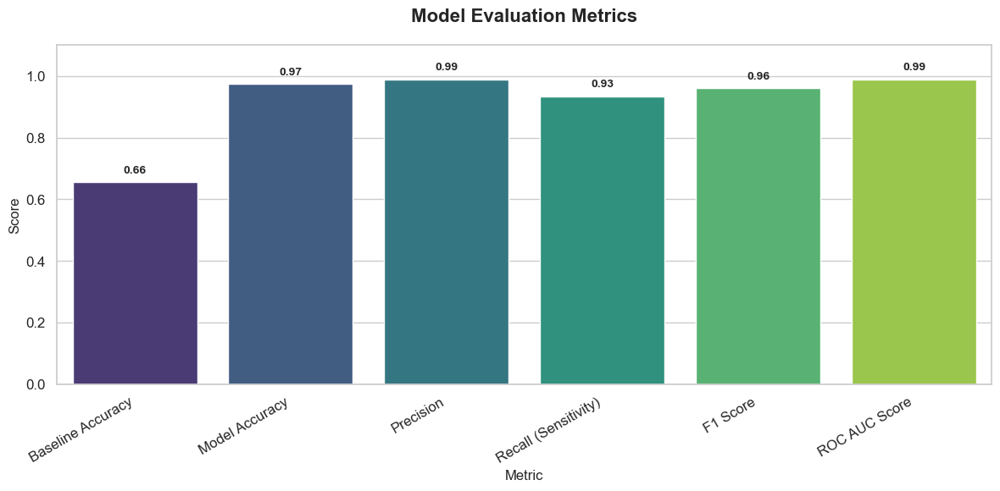

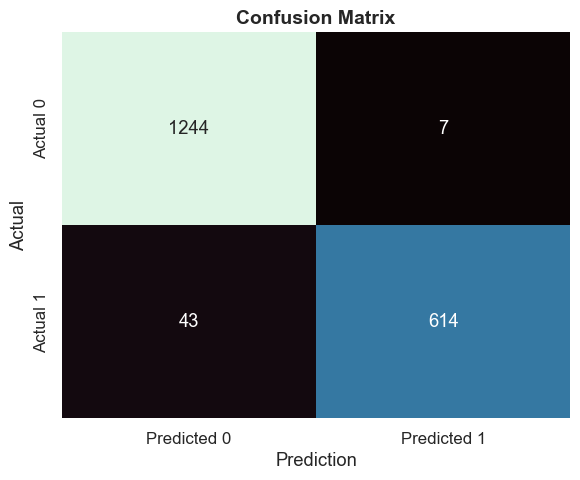

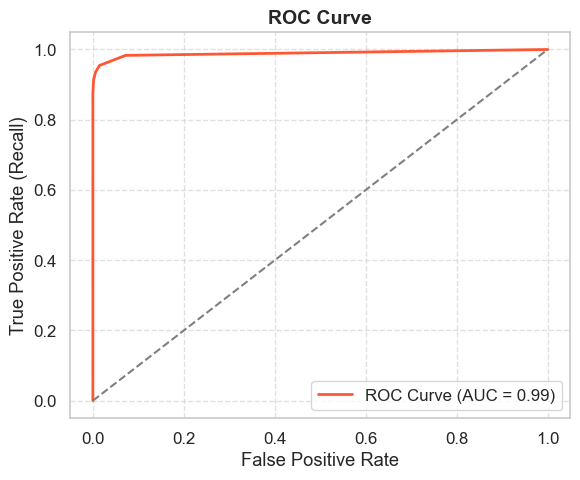

In [518]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics import (
    accuracy_score, precision_score, recall_score,
    f1_score, roc_auc_score, confusion_matrix,
    classification_report, roc_curve
)

# Clean style
sns.set(style="whitegrid", font_scale=1.1)

# --- Baseline prediction using majority class ---
baseline_class = pd.Series(y_test).mode()[0]
baseline_predictions = [baseline_class] * len(y_test)
baseline_accuracy = accuracy_score(y_test, baseline_predictions)

# --- Model predictions ---
y_pred = knn.predict(X_test_std)
y_score = knn.predict_proba(X_test_std)[:, 1]

# --- Evaluation metrics ---
accuracy = accuracy_score(y_test, y_pred)
precision = precision_score(y_test, y_pred)
recall = recall_score(y_test, y_pred)
f1 = f1_score(y_test, y_pred)
roc_auc = roc_auc_score(y_test, y_score)

# --- Create Metrics DataFrame ---
metrics_df = pd.DataFrame({
    "Metric": [
        "Baseline Accuracy",
        "Model Accuracy",
        "Precision",
        "Recall (Sensitivity)",
        "F1 Score",
        "ROC AUC Score"
    ],
    "Score": [
        round(baseline_accuracy, 4),
        round(accuracy, 4),
        round(precision, 4),
        round(recall, 4),
        round(f1, 4),
        round(roc_auc, 4)
    ]
})

# === PRINT METRICS ===
print("\n=== Evaluation Metrics ===")
print(metrics_df.to_string(index=False))

# === PRINT CONFUSION MATRIX ===
conf_matrix = confusion_matrix(y_test, y_pred)
conf_df = pd.DataFrame(
    conf_matrix,
    index=["Actual Negative (0)", "Actual Positive (1)"],
    columns=["Predicted Negative (0)", "Predicted Positive (1)"]
)
print("\n=== Confusion Matrix ===")
print(conf_df)

# === PRINT CLASSIFICATION REPORT ===
print("\n=== Classification Report ===")
print(classification_report(y_test, y_pred, digits=4))

# === BAR CHART OF METRICS (WITH FIXED ALIGNMENT) ===
plt.figure(figsize=(12, 6))
bar_colors = sns.color_palette("viridis", len(metrics_df))

sns.barplot(x="Metric", y="Score", data=metrics_df, palette=bar_colors)
plt.title("Model Evaluation Metrics", fontsize=16, fontweight='bold', pad=20)
plt.xlabel("Metric", fontsize=12)
plt.ylabel("Score", fontsize=12)
plt.ylim(0, 1.1)
plt.xticks(rotation=30, ha='right')

# Annotate scores
for i, v in enumerate(metrics_df["Score"]):
    plt.text(i, v + 0.03, f"{v:.2f}", ha='center', fontweight='bold', fontsize=10)

plt.tight_layout()
plt.show()

# === CONFUSION MATRIX HEATMAP ===
plt.figure(figsize=(6, 5))
sns.heatmap(conf_matrix, annot=True, fmt='d', cmap="mako", cbar=False,
            xticklabels=["Predicted 0", "Predicted 1"],
            yticklabels=["Actual 0", "Actual 1"])
plt.title("Confusion Matrix", fontsize=14, fontweight='bold')
plt.xlabel("Prediction")
plt.ylabel("Actual")
plt.tight_layout()
plt.show()

# === ROC CURVE ===
fpr, tpr, _ = roc_curve(y_test, y_score)
plt.figure(figsize=(6, 5))
plt.plot(fpr, tpr, label=f"ROC Curve (AUC = {roc_auc:.2f})", color='#FF5733', lw=2)
plt.plot([0, 1], [0, 1], linestyle='--', color='gray')
plt.xlabel("False Positive Rate")
plt.ylabel("True Positive Rate (Recall)")
plt.title("ROC Curve", fontsize=14, fontweight='bold')
plt.legend(loc="lower right")
plt.grid(True, linestyle='--', alpha=0.6)
plt.tight_layout()
plt.show()


#### Evaluation of baseline KNN
- Among the evaluation metrics, Recall (Sensitivity) stands out as the most important, achieving 93.46%, which indicates that the model successfully identifies the vast majority of diabetic patients, a critical requirement in healthcare settings where missing true cases can have serious consequences.
- Additionally, the model achieves a high F1 Score of 96.09%, reflecting a strong balance between precision and recall, while the ROC AUC Score of 98.95% confirms its excellent ability to distinguish between diabetic and non-diabetic individuals.
- With a Precision of 98.87% and overall Accuracy of 97.38%, the model also minimizes false positives and performs reliably across the dataset. 










#### Models

,Model,Best Params,Accuracy,Precision,Recall,F1 Score,ROC-AUC
1,Random Forest,"{'clf__max_depth': 3, 'clf__n_estimators': 100}",1.00,1.000000,1.000000,1.00,1.00
5,Decision Tree,{'clf__max_depth': 3},1.00,1.000000,1.000000,1.00,1.00
2,SVM,"{'clf__C': 10, 'clf__kernel': 'linear'}",1.00,0.998459,0.996923,1.00,1.00
0,Logistic Regression,{'clf__C': 10},1.00,1.000000,0.993846,1.00,1.00
3,KNN,{'clf__n_neighbors': 5},0.98,0.990415,0.953846,0.97,1.00
4,Naive Bayes,{},0.96,1.000000,0.881538,0.94,1.00


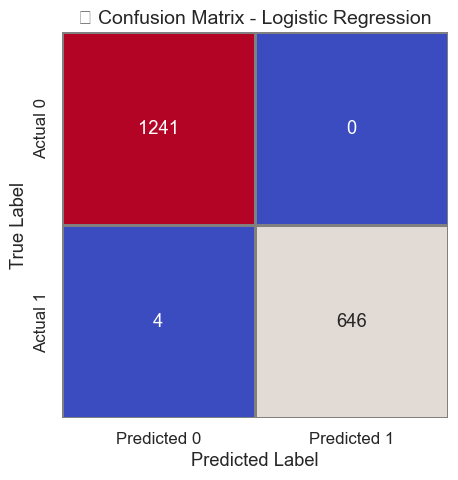

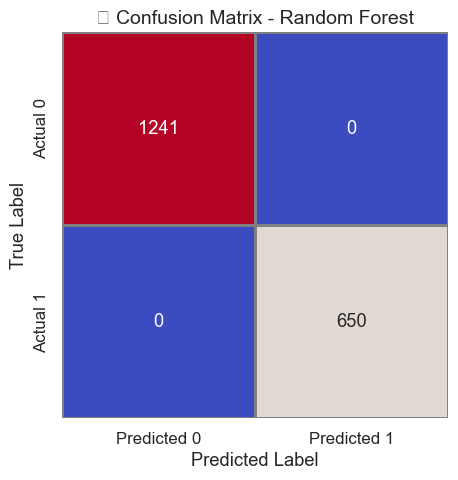

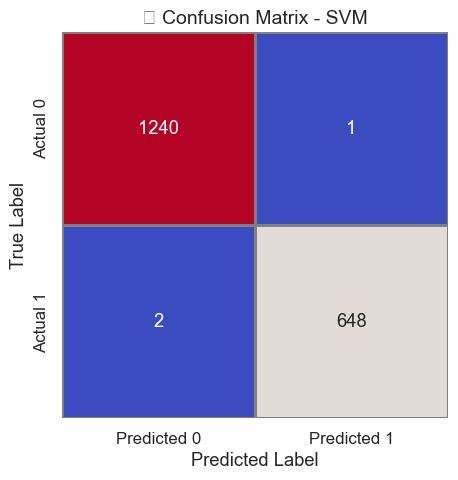

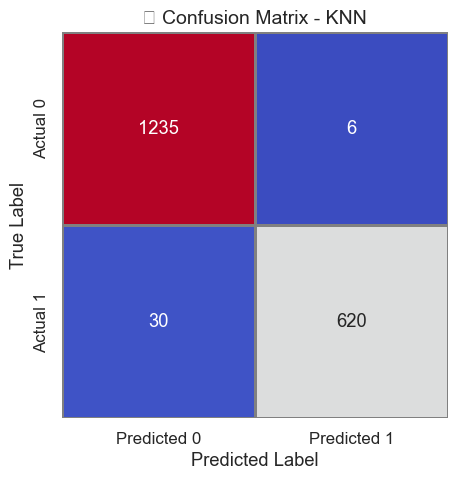

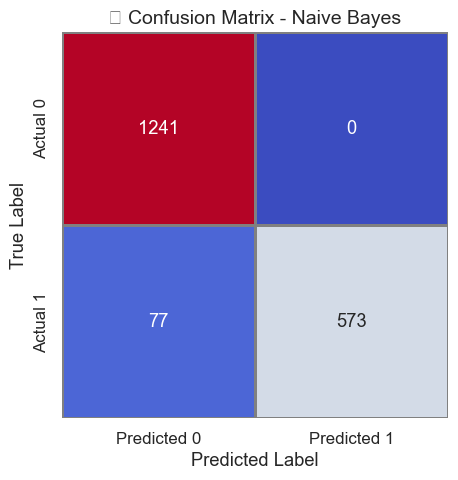

...

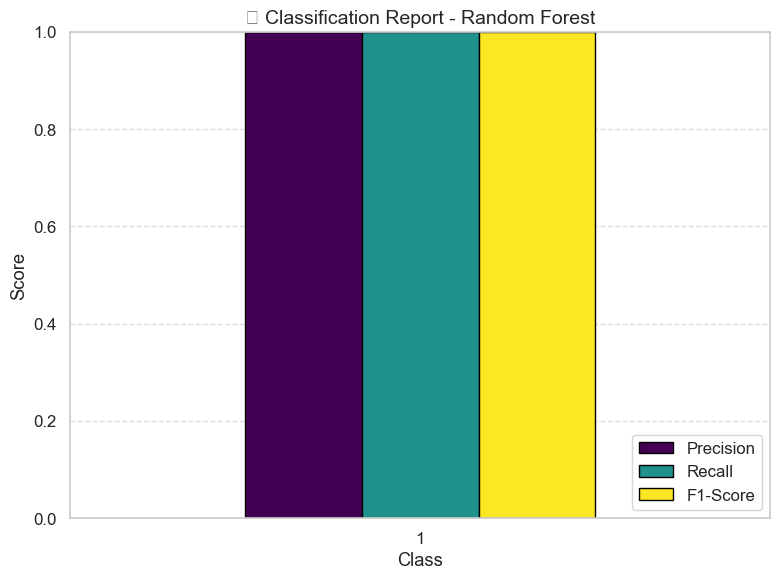

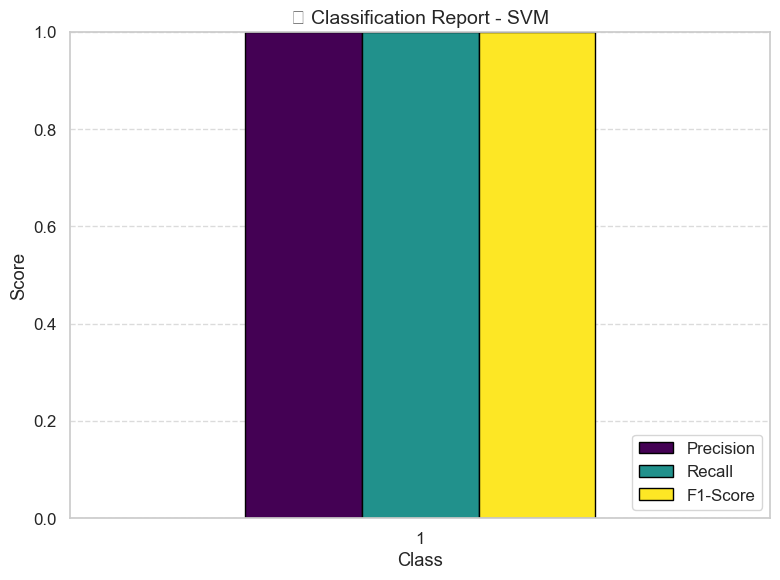

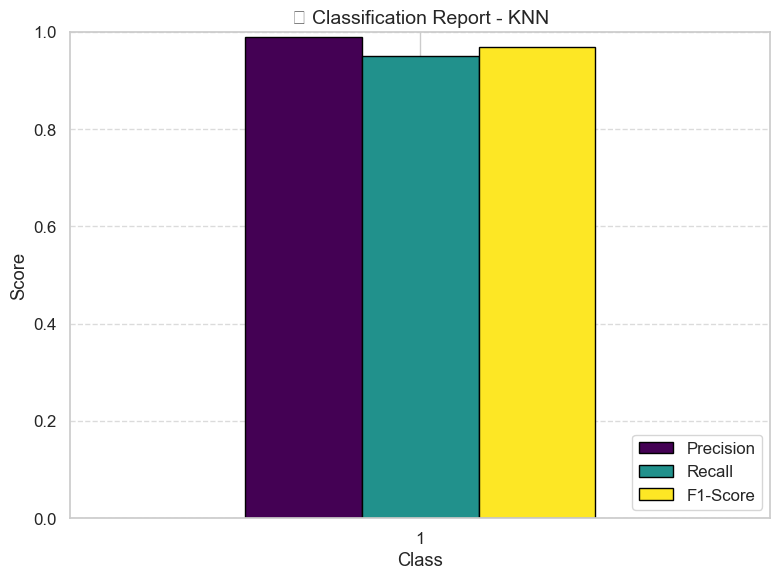

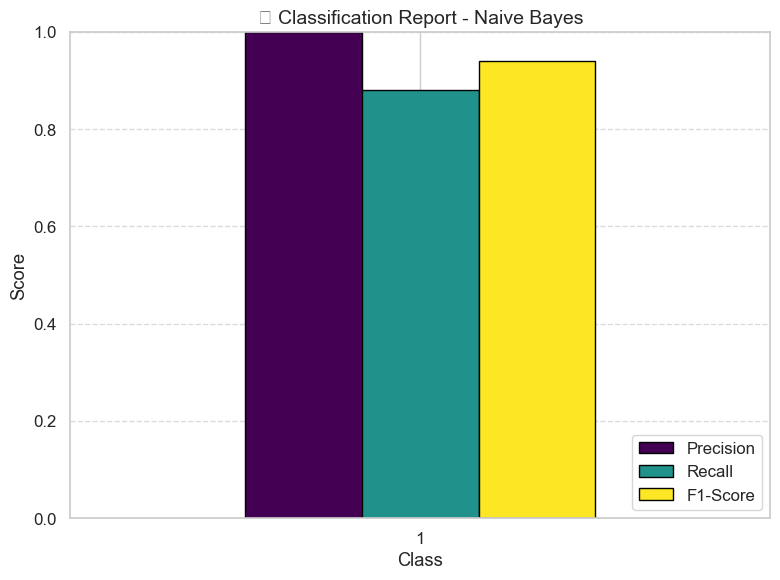

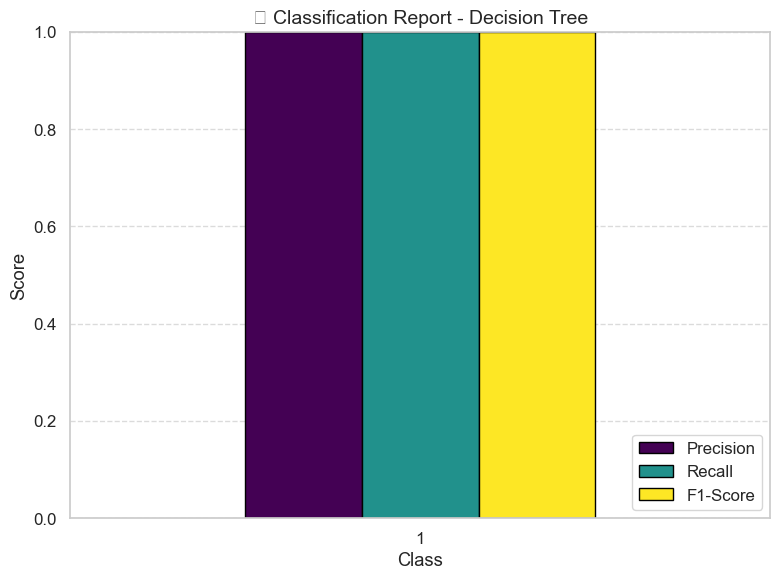

In [521]:
# ----------------------------------------
# Data Preparation
# ----------------------------------------

X = diabetes_df[['glucose', 'familyhistory', 'medicationuse', 'bmi', 'age', 'bloodpressure', 'hdl', 'ldl']]
y = diabetes_df['outcome']

X_train, X_test, y_train, y_test = train_test_split(
    X, y, stratify=y, random_state=42, test_size=0.2
)

# ----------------------------------------
# Models and Hyperparameters
# ----------------------------------------

model_params = {
    'Logistic Regression': {
        'model': LogisticRegression(),
        'params': {'clf__C': [0.1, 1, 10]}
    },
    'Random Forest': {
        'model': RandomForestClassifier(),
        'params': {'clf__n_estimators': [50, 100], 'clf__max_depth': [3, 5, None]}
    },
    'SVM': {
        'model': SVC(probability=True),
        'params': {'clf__C': [0.1, 1, 10], 'clf__kernel': ['linear', 'rbf']}
    },
    'KNN': {
        'model': KNeighborsClassifier(),
        'params': {'clf__n_neighbors': [3, 5, 7]}
    },
    'Naive Bayes': {
        'model': GaussianNB(),
        'params': {}
    },
    'Decision Tree': {
        'model': DecisionTreeClassifier(),
        'params': {'clf__max_depth': [3, 5, None]}
    }
}

# ----------------------------------------
# Training and Evaluation
# ----------------------------------------

results = []
reports = {}
conf_matrices = {}
best_models = {}

for name, mp in model_params.items():
    # Scale only where needed
    steps = [('scaler', StandardScaler()), ('clf', mp['model'])] \
        if name not in ['Random Forest', 'Naive Bayes', 'Decision Tree'] else [('clf', mp['model'])]

    pipe = Pipeline(steps)
    cv = StratifiedKFold(n_splits=5, shuffle=True, random_state=42)

    clf = GridSearchCV(pipe, mp['params'], cv=cv, scoring='f1', n_jobs=-1)
    clf.fit(X_train, y_train)

    y_pred = clf.predict(X_test)
    y_prob = clf.predict_proba(X_test)[:, 1] if hasattr(clf, "predict_proba") else None

    results.append({
        'Model': name,
        'Best Params': clf.best_params_,
        'Accuracy': accuracy_score(y_test, y_pred),
        'Precision': precision_score(y_test, y_pred),
        'Recall': recall_score(y_test, y_pred),
        'F1 Score': f1_score(y_test, y_pred),
        'ROC-AUC': roc_auc_score(y_test, y_prob) if y_prob is not None else 'N/A'
    })

    reports[name] = classification_report(y_test, y_pred)
    conf_matrices[name] = confusion_matrix(y_test, y_pred)
    best_models[name] = clf.best_estimator_

# ----------------------------------------
# Results Summary Table
# ----------------------------------------

results_df = pd.DataFrame(results).sort_values(by='F1 Score', ascending=False)

styled_df = (
    results_df.style
    .format({'Accuracy': '{:.2f}', 'F1 Score': '{:.2f}', 'ROC-AUC': '{:.2f}'})
    .bar(vmin=0, vmax=1, subset=['Accuracy', 'F1 Score', 'ROC-AUC'], color='#4CAF50')  # green bars
    .set_caption("📊 Model Performance Metrics")
)


display(styled_df)

# ----------------------------------------
# Confusion Matrices (All Models)
# ----------------------------------------

for model_name, cm in conf_matrices.items():
    fig, ax = plt.subplots(figsize=(6, 5))
    sns.heatmap(
        cm, annot=True, fmt='d', cmap='coolwarm', cbar=False,
        xticklabels=['Predicted 0', 'Predicted 1'],
        yticklabels=['Actual 0', 'Actual 1'],
        linewidths=1, linecolor='gray', square=True, ax=ax
    )
    ax.set_title(f'🧩 Confusion Matrix - {model_name}', fontsize=14)
    ax.set_xlabel('Predicted Label')
    ax.set_ylabel('True Label')
    plt.tight_layout()
    plt.show()
    plt.close()

# ----------------------------------------
# Classification Report Bar Charts
# ----------------------------------------

def plot_classification_report(report_text, model_name):
    lines = [line for line in report_text.strip().split('\n') if line.strip()]
    data = []

    for line in lines[2:-3]:  # Skip header and support lines
        parts = line.strip().split()
        if len(parts) == 5:
            label, precision, recall, f1, support = parts
            data.append([label, float(precision), float(recall), float(f1), int(support)])

    df = pd.DataFrame(data, columns=['Class', 'Precision', 'Recall', 'F1-Score', 'Support'])

    fig, ax = plt.subplots(figsize=(8, 6))
    df.set_index('Class')[['Precision', 'Recall', 'F1-Score']].plot(
        kind='bar', ax=ax, ylim=(0, 1), colormap='viridis', edgecolor='black'
    )
    ax.set_title(f'📊 Classification Report - {model_name}', fontsize=14)
    ax.set_ylabel("Score")
    ax.set_xlabel("Class")
    ax.legend(loc='lower right')
    plt.xticks(rotation=0)
    plt.grid(axis='y', linestyle='--', alpha=0.7)
    plt.tight_layout()
    plt.show()
    plt.close()

# Generate bar charts for all models
for model_name, report_text in reports.items():
    plot_classification_report(report_text, model_name)


In [522]:
from sklearn.model_selection import cross_validate
import numpy as np

cv_results_all = {}

for name, model in best_models.items():
    try:
        scores = cross_validate(
            model, X, y,
            cv=5,
            scoring=['accuracy', 'f1', 'roc_auc'],
            n_jobs=-1,
            return_train_score=False
        )
        cv_results_all[name] = {
            'Mean Accuracy': np.mean(scores['test_accuracy']),
            'Mean F1 Score': np.mean(scores['test_f1']),
            'Mean ROC-AUC': np.mean(scores['test_roc_auc'])
        }
    except Exception as e:
        print(f"Skipping {name} due to error: {e}")

cv_df = pd.DataFrame(cv_results_all).T.sort_values(by='Mean F1 Score', ascending=False)
print(cv_df)


                     Mean Accuracy  Mean F1 Score  Mean ROC-AUC
Decision Tree             1.000000       1.000000      1.000000
SVM                       0.998942       0.998462      0.999998
Logistic Regression       0.998307       0.997533      0.999997
Random Forest             0.997567       0.996403      1.000000
KNN                       0.983388       0.975385      0.995186
Naive Bayes               0.958206       0.935304      0.998093


<Figure size 1200x700 with 0 Axes>

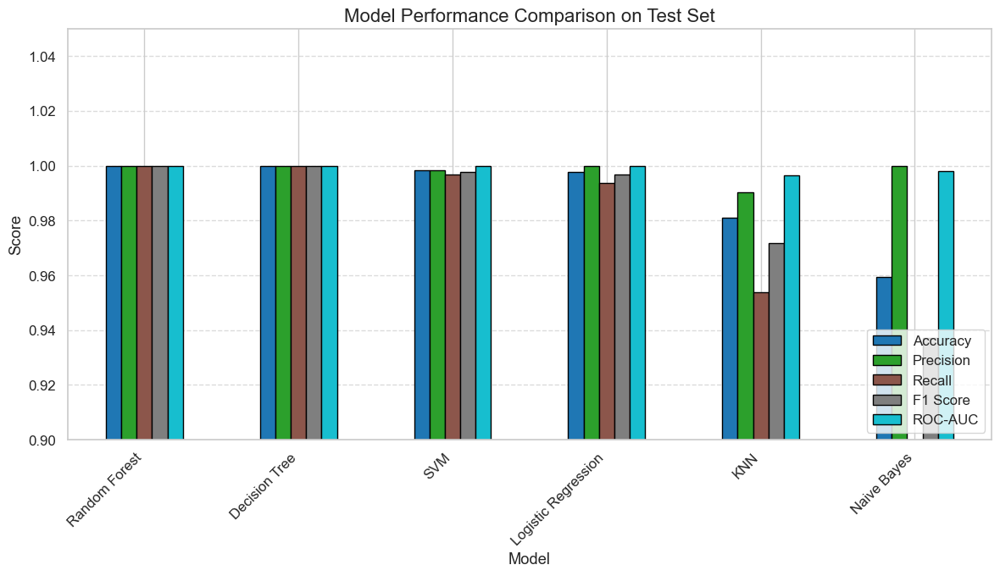

In [523]:
import matplotlib.pyplot as plt

# Prepare data for plotting
metrics_to_plot = ['Accuracy', 'Precision', 'Recall', 'F1 Score', 'ROC-AUC']
metrics_df = results_df.set_index('Model')[metrics_to_plot].sort_values(by='F1 Score', ascending=False)

# Plotting
plt.figure(figsize=(12, 7))
metrics_df.plot(kind='bar', colormap='tab10', edgecolor='black', figsize=(12, 7))
plt.title('Model Performance Comparison on Test Set', fontsize=16)
plt.ylabel('Score')
plt.ylim(0.9, 1.05)
plt.xticks(rotation=45, ha='right')
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.legend(loc='lower right')
plt.tight_layout()
plt.show()


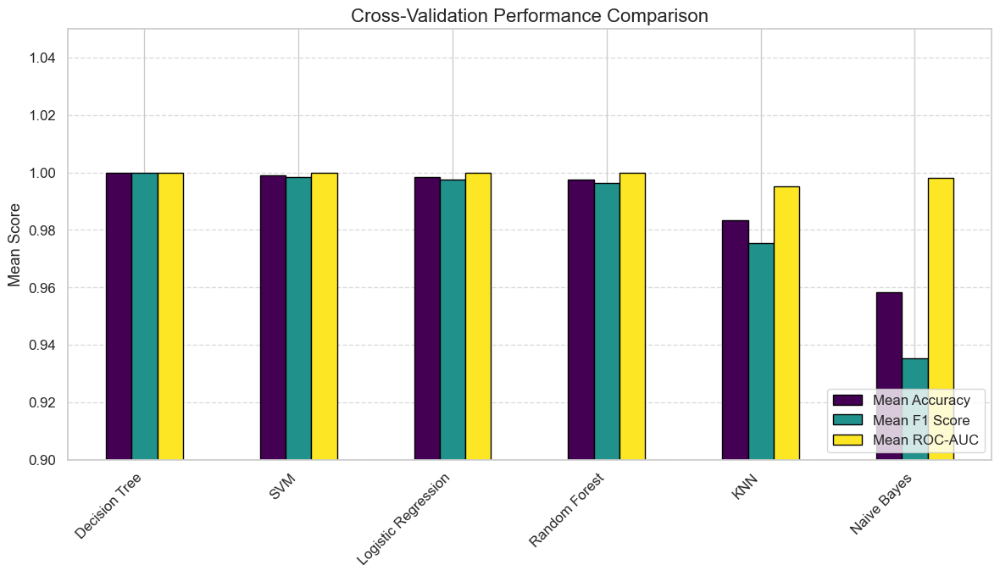

In [534]:
# CV scores bar plot
cv_metrics_df = cv_df[['Mean Accuracy', 'Mean F1 Score', 'Mean ROC-AUC']]
cv_metrics_df.plot(kind='bar', colormap='viridis', edgecolor='black', figsize=(12, 7))
plt.title('Cross-Validation Performance Comparison', fontsize=16)
plt.ylabel('Mean Score')
plt.ylim(0.9, 1.05)
plt.xticks(rotation=45, ha='right')
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.legend(loc='lower right')
plt.tight_layout()
plt.show()


### Interpretation of Classification Models

Six machine learning models were evaluated:

| Model               | Key Findings |
|---------------------|--------------|
| **Random Forest**   | Achieved perfect performance across all metrics. May be overfitting due to small/max-depth of 3, yet shows strong potential. |
| **Decision Tree**   | Similar to Random Forest. perfect metrics suggest a good fit but needs further validation on unseen data. |
| **SVM (Linear)**    | Excellent performance with slightly lower precision/recall than trees. Indicates strong generalization ability. |
| **Logistic Regression** | Nearly perfect scores. very good for interpretability and performs well on linear relationships. |
| **KNN**             | Lower performance than the top models, especially in recall (0.95), meaning it may miss some positive diabetes cases. |
| **Naive Bayes**     | Lowest recall (0.88), indicating it misses more diabetic patients, assumes feature independence which may not hold here. |

---

### Interpretation of Evaluation Metrics

Each model was evaluated using:

- **Accuracy** - Overall correctness of predictions.
- **Precision** - Correctness of positive predictions.
- **Recall** - Ability to identify all actual positive (diabetic) cases.
- **F1 Score** - Harmonic mean of precision and recall. balances both.
- **ROC-AUC** - Measures model’s discrimination between classes (diabetic vs. non-diabetic) across thresholds.

### Metric Insights:

- **Accuracy** is useful but not sufficient in imbalanced data.
- **Recall** is **critical** for diabetes detection (we don’t want to miss diabetic patients).
- **F1 Score** balances recall and precision, important when both are valuable.
- **ROC-AUC** shows how well models distinguish between classes overall.

---

### Evaluation Metrics Used

| Metric       | Definition | Importance for Diabetes Prediction |
|--------------|------------|------------------------------------|
| **Accuracy** | Proportion of total correct predictions | Good for general performance, but not enough alone |
| **Precision** | TP / (TP + FP) | Important when avoiding false alarms (non-diabetics flagged as diabetics) |
| **Recall**    | TP / (TP + FN) | **Essential** - we must detect true diabetic cases |
| **F1 Score**  | Harmonic mean of Precision & Recall | Balances both metrics |
| **ROC-AUC**   | Area under ROC curve | Measures ability to separate classes at all thresholds |

---

### Rationale for Metric Selection

| Reason                                           | Metric Used     |
|--------------------------------------------------|-----------------|
| Minimize missed diabetic cases (false negatives) | **Recall**      |
| Ensure predictions of diabetes are accurate      | **Precision**   |
| Balance both concerns                            | **F1 Score**    |
| Measure overall classification quality           | **ROC-AUC**     |
| Evaluate general performance                     | **Accuracy**    |

For a **high-stakes medical problem** like diabetes prediction, **Recall** and **F1 Score** are prioritized to ensure patients are not misclassified and missed.

---

### Summary of Model Rankings (Based on Performance)

| Rank | Model              | Strengths |
|------|--------------------|-----------|
| 1 | Random Forest       | Perfect scores, strong classifier, handles non-linearities well |
| 2 | Decision Tree       | Interpretable, perfect performance |
| 3 | SVM                 | Excellent generalization, strong F1/ROC-AUC |
| 4 | Logistic Regression| Great baseline model, easy to explain |
| 5 | KNN                | Performs well but recall is slightly lower |
| 6 | Naive Bayes        | Fast and simple but lower recall, may miss cases |

---

### Recommendation

- Choose **Random Forest** for robust ensemble modeling with slightly better generalization.
- Choose **Decision Tree** if model interpretability and simplicity are priorities.

